##  Import Libraries 

In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

# Load Dataset 

In [2]:
email = pd.read_csv("Emails.csv")
email.head()

,Unnamed: 0,filename,Message-ID,content,Class
0,0,arnold-j/_sent_mail/34.,<15267340.1075857594923.JavaMail.evans@thyme>,eat shit\n\n\n\n\nJohn J Lavorato@excelr\n11/1...,Abusive
1,1,arnold-j/_sent_mail/517.,<15539583.1075857652152.JavaMail.evans@thyme>,fuck you,Abusive
2,2,arnold-j/_sent_mail/743.,<4339799.1075857657711.JavaMail.evans@thyme>,Gentlemen:\nThe following champagne is availab...,Abusive
3,3,arnold-j/_sent_mail/766.,<25574783.1075857658215.JavaMail.evans@thyme>,sorry i've taken so long...just been trying to...,Abusive
4,4,arnold-j/_sent_mail/797.,<19506151.1075857658895.JavaMail.evans@thyme>,asshole\n\n\n\n\nJohn J Lavorato@excelr\n12/23...,Abusive


In [3]:
email.shape

(48076, 5)

In [4]:
email.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48076 entries, 0 to 48075
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  48076 non-null  int64 
 1   filename    48076 non-null  object
 2   Message-ID  48076 non-null  object
 3   content     48076 non-null  object
 4   Class       48076 non-null  object
dtypes: int64(1), object(4)
memory usage: 1.8+ MB


In [5]:
email.describe()

,Unnamed: 0
count,48076.000000
mean,24037.500000
std,13878.490108
min,0.000000
25%,12018.750000
50%,24037.500000
75%,36056.250000
max,48075.000000


# Exploratory Data Analysis 

###  1) checking for null values 

In [6]:
email.isnull().sum()

Unnamed: 0    0
filename      0
Message-ID    0
content       0
Class         0
dtype: int64

###  Hence there are no null values in the dataset 

###   2) Removing the unwanted columns 

In [7]:
new_em = email.drop(["Unnamed: 0","filename","Message-ID"],axis=1)
new_em

,content,Class
0,eat shit\n\n\n\n\nJohn J Lavorato@excelr\n11/1...,Abusive
1,fuck you,Abusive
2,Gentlemen:\nThe following champagne is availab...,Abusive
3,sorry i've taken so long...just been trying to...,Abusive
4,asshole\n\n\n\n\nJohn J Lavorato@excelr\n12/23...,Abusive
...,...,...
48071,"Dear Market Participants,\n\nPlease note the c...",Non Abusive
48072,"According to my fancy ciphering we made $310,0...",Non Abusive
48073,BUSINESS HIGHLIGHTS\n\nWeather Group\n\nLet=01...,Non Abusive
48074,Welcome to: DIAMONDS NEWSLETTER Issue:...,Non Abusive


###   3) Checking for duplicate values 

In [8]:
new_em[new_em.duplicated()]

,content,Class
7,sorry i've taken so long...just been trying to...,Abusive
8,asshole\n\n\n\n\nJohn J Lavorato@excelr\n12/23...,Abusive
9,asshole\n\n\n\n\nJohn J Lavorato@excelr\n12/24...,Abusive
10,eat shit\n\n\n\n\nJohn J Lavorato@excelr\n11/1...,Abusive
11,Do you know my hr rep's name?\n\n\n\nJennifer ...,Abusive
...,...,...
48071,"Dear Market Participants,\n\nPlease note the c...",Non Abusive
48072,"According to my fancy ciphering we made $310,0...",Non Abusive
48073,BUSINESS HIGHLIGHTS\n\nWeather Group\n\nLet=01...,Non Abusive
48074,Welcome to: DIAMONDS NEWSLETTER Issue:...,Non Abusive


###  There are 23420 duplicate rows in the dataset so we need to drop the duplicated rows from the dataset 

In [9]:
new_con = new_em.drop_duplicates(ignore_index=True)
new_con

,content,Class
0,eat shit\n\n\n\n\nJohn J Lavorato@excelr\n11/1...,Abusive
1,fuck you,Abusive
2,Gentlemen:\nThe following champagne is availab...,Abusive
3,sorry i've taken so long...just been trying to...,Abusive
4,asshole\n\n\n\n\nJohn J Lavorato@excelr\n12/23...,Abusive
...,...,...
24651,Do you need new leads for your business ?\n D...,Non Abusive
24652,"[IMAGE]\n [IMAGE] [IMAGE] GARTH BROOKS ""...",Non Abusive
24653,\n[IMAGE][IMAGE][IMAGE] \nDear SmartReminders ...,Non Abusive
24654,\n[IMAGE]\n [IMAGE] [IMAGE] [IMAGE] KID ...,Non Abusive


###  Hence the dataset contain 24656 unique rows 

###   4) checking target variable 

In [10]:
new_con['Class'].value_counts()

Non Abusive    23014
Abusive         1642
Name: Class, dtype: int64

<AxesSubplot:xlabel='Class', ylabel='count'>

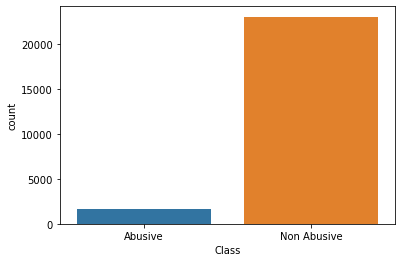

In [11]:
sns.countplot(new_con['Class'])

###  Hence the dataset contain imbalanced class  

#  Preprocessing 

In [12]:
import re
import string
import nltk
nltk.download('wordnet')
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
nltk.download('punkt')
nltk.download('stopwords')
from textblob import TextBlob

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\NITHU\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\NITHU\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\NITHU\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [13]:
doc = pd.DataFrame(new_con.content)
doc

,content
0,eat shit\n\n\n\n\nJohn J Lavorato@excelr\n11/1...
1,fuck you
2,Gentlemen:\nThe following champagne is availab...
3,sorry i've taken so long...just been trying to...
4,asshole\n\n\n\n\nJohn J Lavorato@excelr\n12/23...
...,...
24651,Do you need new leads for your business ?\n D...
24652,"[IMAGE]\n [IMAGE] [IMAGE] GARTH BROOKS ""..."
24653,\n[IMAGE][IMAGE][IMAGE] \nDear SmartReminders ...
24654,\n[IMAGE]\n [IMAGE] [IMAGE] [IMAGE] KID ...


In [14]:
doc.content[0]

'eat shit\n\n\n\n\nJohn J Lavorato@excelr\n11/18/2000 01:01 PM\nTo: John Arnold/HOU/ECT@ECT\ncc:  \nSubject: \n\nFootball bets 200 each\n\nMinn -9.5\nBuff +2.5\nPhil -7\nIndi -4.5\nCinnci +7\nDet +6\nclev +16\nDen +9.5\nDall +7.5\nJack +3.5\n\n\n'

###    Cleaning

In [15]:
def clean_text(text):
    text = text.lower()                                                        # lower case
    text = re.sub(r"\S*https?:\S*", " ", text)                                 # removing links
    text = re.sub('[^a-zA-Z]',' ', text) 
    text = re.sub('\[.*?\]', ' ', text)                                        # removing text in square brackets
    text = re.sub(r"[’…]", " ", text)                                          # removing special chracters
    text = re.sub("[0-9" "]+"," ",text)                                        # removing numbers
    text = text.translate(str.maketrans(' ', ' ', string.punctuation))         # remove punctuations
    text_tokens = word_tokenize(text)                                          # Tokenization
    stop_words = stopwords.words('english')
    new_stop_words = ['cc','pm','subject','also','td','hou','ect','br','tr','com','excelr','www','image','font']
    stop_words.extend(new_stop_words)
    stop_tokens = [word for word in text_tokens if not word in stop_words]     # Remove stop words
    stop_text = ' '.join(stop_tokens)
    lemmas = TextBlob(stop_text)         
    lemmas_token = [w.lemmatize() for w in lemmas.words]                       # Lemmatization
    lemmas_text = ' '.join(lemmas_token)  
    return lemmas_text
clean = lambda x: clean_text(x)

In [16]:
doc["CONTENT"] = doc["content"].apply(clean)
doc

,content,CONTENT
0,eat shit\n\n\n\n\nJohn J Lavorato@excelr\n11/1...,eat shit john j lavorato john arnold football ...
1,fuck you,fuck
2,Gentlemen:\nThe following champagne is availab...,gentleman following champagne available approx...
3,sorry i've taken so long...just been trying to...,sorry taken long trying fend chick life sooooo...
4,asshole\n\n\n\n\nJohn J Lavorato@excelr\n12/23...,asshole john j lavorato john arnold john cant ...
...,...,...
24651,Do you need new leads for your business ?\n D...,need new lead business need increased internet...
24652,"[IMAGE]\n [IMAGE] [IMAGE] GARTH BROOKS ""...",garth brook wrapped win ticket trip garth broo...
24653,\n[IMAGE][IMAGE][IMAGE] \nDear SmartReminders ...,dear smartreminders member franchoice free one...
24654,\n[IMAGE]\n [IMAGE] [IMAGE] [IMAGE] KID ...,kid rock forever official kid rock site kidroc...


In [17]:
doc.CONTENT[0]

'eat shit john j lavorato john arnold football bet minn buff phil indi cinnci det clev den dall jack'

In [18]:
doc.CONTENT[24652]

'garth brook wrapped win ticket trip garth brook show hey launcher week country king garth brook releasing first album four year scarecrow planning one three spectacula r show celebrate great event titled garth brook coast coast triad show aired live cbs tv one lucky launcher plus guest get attend enter chance win two ticket garth final coast show held secret location november th travel accommodation taken ca enter cross finger miss stream video hit single wrapped n order copy scarecrow today yahoo shopping stay tuned launch newsletter sent launch medium inc unsubscribe prefer receive future e mail launc h medium'

In [19]:
text = ','.join(doc["CONTENT"])
text

'eat shit john j lavorato john arnold football bet minn buff phil indi cinnci det clev den dall jack,fuck,gentleman following champagne available approximate retail price interest trading red wine retail price derived spec website winesearcer wine stored temperature controlled private wine storage facility quan vintage wine retail perrier jouet brut fleur de champagne piper heidsek reserve dom perignon veuve cliquot ponsardin la grande dame taittenger millesine brut jacquart millesine roederer cristal interest,sorry taken long trying fend chick life sooooo hard sometimes monkey brian rourke communication john arnold yeah monkey monkey hey little bastard fuck picture e company think help score woman say balance sheet yeah monkey b,asshole john j lavorato john arnold john cant seem make gambling problem go away bill denver jack,asshole john j lavorato john arnold ram wash raider balt bear lion eagle bengal pat viking,know hr rep name jennifer burn john arnold shit head,hey stupid almost 

###    N-Gram 

###   a) Unigram

In [29]:
from sklearn.feature_extraction.text import CountVectorizer

In [30]:
def get_unigrams(corpus, n=None):
    cv_uni = CountVectorizer(ngram_range=(1,1), max_features=5000).fit(corpus)
    bag_words = cv_uni.transform(corpus)
    sum_words = bag_words.sum(axis=0) 
    freq_words = [(word, sum_words[0, idx]) for word, idx in cv_uni.vocabulary_.items()]
    freq_words =sorted(freq_words, key = lambda x: x[1], reverse=True)
    return freq_words[:n]

In [31]:
top_words = get_unigrams(doc["CONTENT"], n=150) 
top_150 = pd.DataFrame(top_words)
top_150.columns=["Unigram", "Freq"]
top_150.head(15)

,Unigram,Freq
0,please,17045
1,time,15520
2,message,13496
3,would,12848
4,new,12146
5,sent,11782
6,week,11520
7,one,11353
8,size,10806
9,get,10629


[Text(0, 0, 'please'),
 Text(1, 0, 'time'),
 Text(2, 0, 'message'),
 Text(3, 0, 'would'),
 Text(4, 0, 'new'),
 Text(5, 0, 'sent'),
 Text(6, 0, 'week'),
 Text(7, 0, 'one'),
 Text(8, 0, 'size'),
 Text(9, 0, 'get'),
 Text(10, 0, 'original'),
 Text(11, 0, 'mail'),
 Text(12, 0, 'right'),
 Text(13, 0, 'may'),
 Text(14, 0, 'align'),
 Text(15, 0, 'company'),
 Text(16, 0, 'day'),
 Text(17, 0, 'know'),
 Text(18, 0, 'john'),
 Text(19, 0, 'year')]

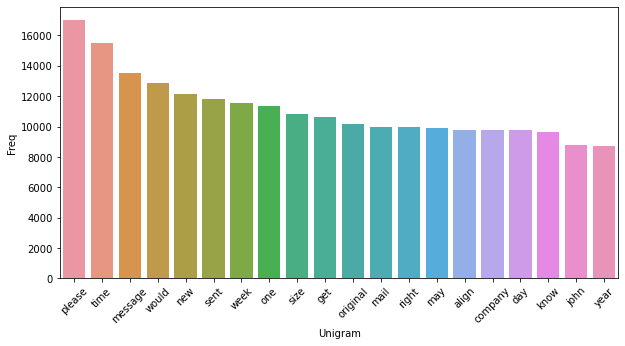

In [32]:
top_uni = top_150.iloc[0:20,:]
fig = plt.figure(figsize = (10, 5))
plot=sns.barplot(x=top_uni["Unigram"],y=top_uni["Freq"])
plot.set_xticklabels(rotation=45,labels = top_uni["Unigram"])

###   b) Bigram

In [33]:
def get_Bigrams(corpus, n=None):
    cv_bi= CountVectorizer(ngram_range=(2,2), max_features=5000).fit(corpus)
    bag_words = cv_bi.transform(corpus)
    sum_words = bag_words.sum(axis=0) 
    freq_words = [(word, sum_words[0, idx]) for word, idx in cv_bi.vocabulary_.items()]
    freq_words =sorted(freq_words, key = lambda x: x[1], reverse=True)
    return freq_words[:n]

In [34]:
top_words = get_Bigrams(doc["CONTENT"], n=200) 
top_200 = pd.DataFrame(top_words)
top_200.columns=["Bi-gram", "Freq"]
top_200.head(15)

,Bi-gram,Freq
0,original message,9382
1,align right,5423
2,let know,4705
3,class align,3985
4,face arial,3962
5,arial helvetica,3551
6,would like,2744
7,eric bass,2713
8,sally beck,2308
9,new york,2167


[Text(0, 0, 'original message'),
 Text(1, 0, 'align right'),
 Text(2, 0, 'let know'),
 Text(3, 0, 'class align'),
 Text(4, 0, 'face arial'),
 Text(5, 0, 'arial helvetica'),
 Text(6, 0, 'would like'),
 Text(7, 0, 'eric bass'),
 Text(8, 0, 'sally beck'),
 Text(9, 0, 'new york'),
 Text(10, 0, 'width height'),
 Text(11, 0, 'sent monday'),
 Text(12, 0, 'sent tuesday'),
 Text(13, 0, 'align middle'),
 Text(14, 0, 'helvetica size'),
 Text(15, 0, 'please let'),
 Text(16, 0, 'ee ee'),
 Text(17, 0, 'size updated'),
 Text(18, 0, 'right size'),
 Text(19, 0, 'size align')]

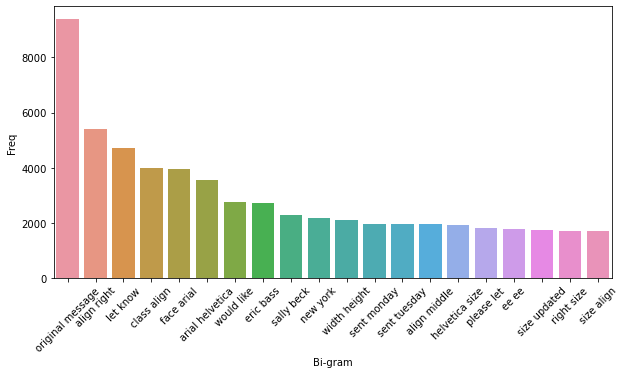

In [35]:
top_bi = top_200.iloc[0:20,:]
fig = plt.figure(figsize = (10, 5))
plot=sns.barplot(x=top_bi["Bi-gram"],y=top_bi["Freq"])
plot.set_xticklabels(rotation=45,labels = top_bi["Bi-gram"])

###   c) Trigram 

In [36]:
def get_Trigrams(corpus, n=None):
    cv_tri = CountVectorizer(ngram_range=(3,3), max_features=5000).fit(corpus)
    bag_words = cv_tri.transform(corpus)
    sum_words = bag_words.sum(axis=0) 
    freq_words = [(word, sum_words[0, idx]) for word, idx in cv_tri.vocabulary_.items()]
    freq_words =sorted(freq_words, key = lambda x: x[1], reverse=True)
    return freq_words[:n]

In [37]:
top_words = get_Trigrams(doc["CONTENT"], n=250) 
top_250 = pd.DataFrame(top_words)
top_250.columns=["Tri-gram", "Freq"]
top_250.head(15)

,Tri-gram,Freq
0,face arial helvetica,3210
1,class align right,2810
2,arial helvetica size,1933
3,align right size,1715
4,please let know,1676
5,updated face arial,1665
6,size updated face,1664
7,right size align,1650
8,size align right,1374
9,align right class,1278


[Text(0, 0, 'face arial helvetica'),
 Text(1, 0, 'class align right'),
 Text(2, 0, 'arial helvetica size'),
 Text(3, 0, 'align right size'),
 Text(4, 0, 'please let know'),
 Text(5, 0, 'updated face arial'),
 Text(6, 0, 'size updated face'),
 Text(7, 0, 'right size align'),
 Text(8, 0, 'size align right'),
 Text(9, 0, 'align right class'),
 Text(10, 0, 'right class align'),
 Text(11, 0, 'prc position active'),
 Text(12, 0, 'img width height'),
 Text(13, 0, 'class align middle'),
 Text(14, 0, 'central standard time'),
 Text(15, 0, 'nbsp nbsp nbsp'),
 Text(16, 0, 'date time central'),
 Text(17, 0, 'time central standard'),
 Text(18, 0, 'outlook migration team'),
 Text(19, 0, 'calendar entry appointment')]

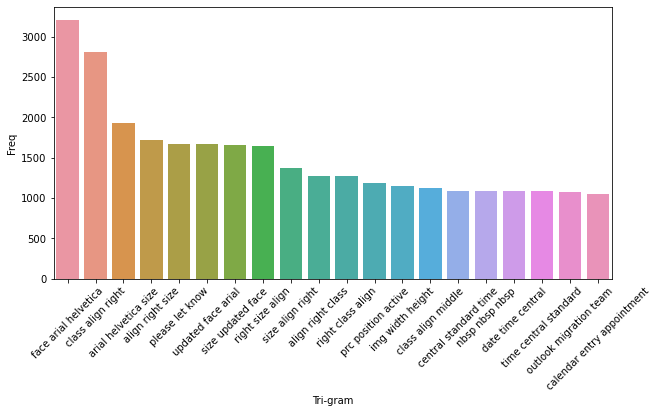

In [38]:
top_tri = top_250.iloc[0:20,:]
fig = plt.figure(figsize = (10, 5))
plot=sns.barplot(x=top_tri["Tri-gram"],y=top_tri["Freq"])
plot.set_xticklabels(rotation=45,labels = top_tri["Tri-gram"])

## WordCloud

In [39]:
from wordcloud import WordCloud

In [40]:
def plot_cloud(wordcloud):
    plt.figure(figsize=(40, 30))
    plt.imshow(wordcloud) 
    plt.axis("off")

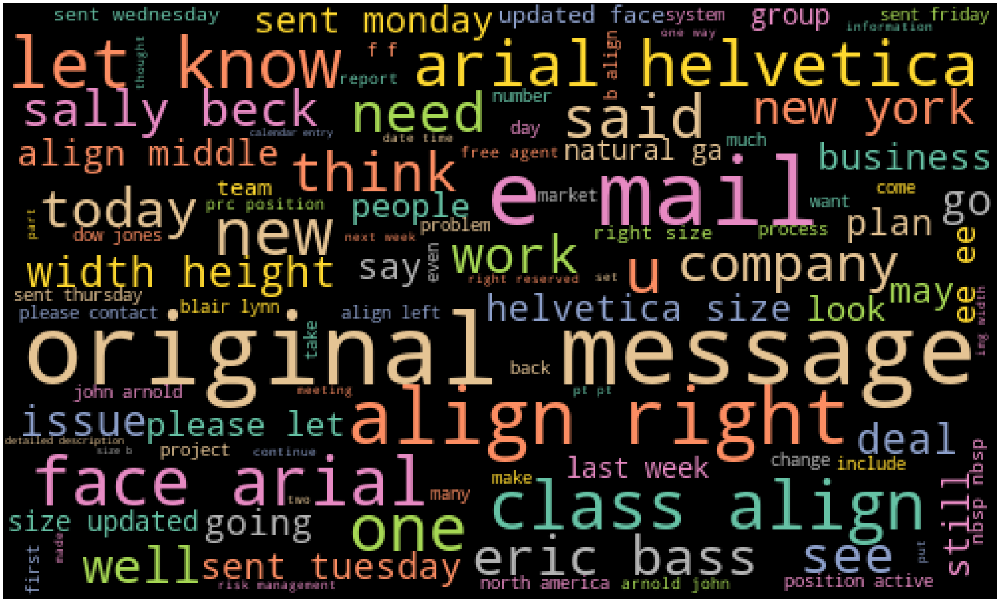

In [41]:
wordcloud = WordCloud(width = 500, height = 300, background_color='black', max_words=100,colormap='Set2').generate(text)
plot_cloud(wordcloud)

###    Copying dataset to csv 

In [42]:
doc['CLASS'] = new_em.Class
doc

,content,CONTENT,CLASS
0,eat shit\n\n\n\n\nJohn J Lavorato@excelr\n11/1...,eat shit john j lavorato john arnold football ...,Abusive
1,fuck you,fuck,Abusive
2,Gentlemen:\nThe following champagne is availab...,gentleman following champagne available approx...,Abusive
3,sorry i've taken so long...just been trying to...,sorry taken long trying fend chick life sooooo...,Abusive
4,asshole\n\n\n\n\nJohn J Lavorato@excelr\n12/23...,asshole john j lavorato john arnold john cant ...,Abusive
...,...,...,...
24651,Do you need new leads for your business ?\n D...,need new lead business need increased internet...,Non Abusive
24652,"[IMAGE]\n [IMAGE] [IMAGE] GARTH BROOKS ""...",garth brook wrapped win ticket trip garth broo...,Non Abusive
24653,\n[IMAGE][IMAGE][IMAGE] \nDear SmartReminders ...,dear smartreminders member franchoice free one...,Non Abusive
24654,\n[IMAGE]\n [IMAGE] [IMAGE] [IMAGE] KID ...,kid rock forever official kid rock site kidroc...,Non Abusive


In [43]:
new_email = doc.drop(['content'],axis=1)
new_email

,CONTENT,CLASS
0,eat shit john j lavorato john arnold football ...,Abusive
1,fuck,Abusive
2,gentleman following champagne available approx...,Abusive
3,sorry taken long trying fend chick life sooooo...,Abusive
4,asshole john j lavorato john arnold john cant ...,Abusive
...,...,...
24651,need new lead business need increased internet...,Non Abusive
24652,garth brook wrapped win ticket trip garth broo...,Non Abusive
24653,dear smartreminders member franchoice free one...,Non Abusive
24654,kid rock forever official kid rock site kidroc...,Non Abusive


In [44]:
new_email.to_csv('new_email.csv',index=False)